In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


# PPMI+ baseline model 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import matplotlib.pyplot as plt
from tensorflow.keras.models import model_from_json
import numpy as np
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import layers
from tensorflow.keras.layers import BatchNormalization,Conv2D,Dropout,LeakyReLU, Dense,GlobalAveragePooling2D,Flatten,concatenate,Input
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping 
from tensorflow.keras import regularizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from os import listdir
from matplotlib import image
np.random.seed(42)
train_dir_norm_ppmi_play = "/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/Alphapose/train_alpha"
test_dir_norm_ppmi_play ="/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/Alphapose/test_alpha"
val_dir_norm_ppmi_play = "/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/Alphapose/val_alpha"
train_dir_norm_ppmi_play_baseline = "/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/train_play"
test_dir_norm_ppmi_play_baseline ="/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/test_play"
val_dir_norm_ppmi_play_baseline = "/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/val_play"
print(tf.__version__)

2.3.0


Loading the dataset

In [ ]:
def load_data(data_dir_train,data_dir_val,data_dir_test,Shuffle):
    
    print("Loading dataset")
    train_datagen = ImageDataGenerator(
     )#no data augmentation just loading
    val = ImageDataGenerator()
    test = ImageDataGenerator()
    train= train_datagen.flow_from_directory(data_dir_train,seed=42,target_size=(224,224),class_mode ='categorical',batch_size=32,shuffle=Shuffle)
    val= val.flow_from_directory(data_dir_val,seed=42,target_size=(224,224),class_mode ='categorical',batch_size=32,shuffle=Shuffle)
    test = test.flow_from_directory(data_dir_test,seed=42,target_size= (224,224),class_mode='categorical',batch_size=32,shuffle=Shuffle)
    print("Finished preparing dataloaders")

    return train, val, test
train_pose,val_pose,test_pose = load_data(train_dir_norm_ppmi_play,val_dir_norm_ppmi_play,test_dir_norm_ppmi_play,False)
train_baseline,val_baseline,test_baseline = load_data(train_dir_norm_ppmi_play_baseline,val_dir_norm_ppmi_play_baseline,test_dir_norm_ppmi_play_baseline,False)

Loading dataset
Found 960 images belonging to 12 classes.
Found 240 images belonging to 12 classes.
Found 1200 images belonging to 12 classes.
Finished preparing dataloaders
Loading dataset
Found 960 images belonging to 12 classes.
Found 240 images belonging to 12 classes.
Found 1200 images belonging to 12 classes.
Finished preparing dataloaders


In [ ]:
def get_labels(data,train_labels=[]):
  number_of_examples = len(data.filenames)
  number_of_generator_calls = np.math.ceil(number_of_examples / (1.0 * 32)) 


  for i in range(0,int(number_of_generator_calls)):
      train_labels.extend(np.array(data[i][1]))
  return train_labels
def get_features(data,features=[]):
  number_of_examples = len(data.filenames)
number_of_generator_calls = np.math.ceil(number_of_examples / (1.0 * 32)) 

  for i in range(0,int(number_of_generator_calls)):
      features.extend(np.array(data[i][0]))
  return features


Here we receive the labels and features of our dataset (load whole batch, needs around 15-20 minutes to load, slow load due to google colab ).

In [ ]:
train_labels_baseline = np.array(get_labels(train_baseline, []))
train_labels_pose = np.array(get_labels(train_pose,[]))
val_labels_baseline = np.array(get_labels(val_baseline,[]))
val_labels_pose = np.array(get_labels(val_pose,[]))


In [ ]:
test_labels_baseline = np.array(get_labels(test_baseline,[]))
test_labels_pose = np.array(get_labels(test_pose,[]))

In [ ]:

train_features_baseline = np.array(get_features(train_baseline,[]))
train_features_alphapose = np.array(get_features(train_pose,[]))
val_features_baseline = np.array(get_features(val_baseline,[]))
val_features_alphapose = np.array(get_features(val_pose,[]))

#if this cell takes a lot of time, interrupt runtime and rerun cell.


In [ ]:
test_features_baseline = np.array(get_features(test_baseline,[]))
test_features_alphapose = np.array(get_features(test_pose,[]))

In [ ]:
from sklearn.utils import shuffle
y_train = shuffle(train_labels_baseline,random_state=42)
x_train = shuffle(train_features_baseline,random_state=42)
y_train_pose = shuffle(train_labels_pose,random_state=42)
x_train_pose = shuffle(train_features_alphapose,random_state=42)
y_val = shuffle(val_labels_baseline,random_state=42)
x_val = shuffle(val_features_baseline,random_state=42)
y_val_pose = shuffle(val_labels_pose,random_state=42)
x_val_pose = shuffle(val_features_alphapose,random_state=42)
y_test = shuffle(test_labels_baseline,random_state=42)
x_test = shuffle(test_features_baseline,random_state=42)
y_test_pose = shuffle(test_labels_pose,random_state=42)
x_test_pose = shuffle(test_features_alphapose,random_state=42)

Visualizing an image from our dataset

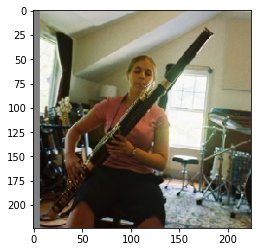

In [ ]:
plt.imshow(train_features_baseline[0]/255.)

Visualizing the same image but with its alphapose

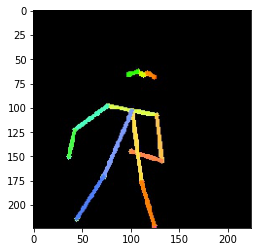

In [ ]:
plt.imshow(train_features_alphapose[0]/255.)

Loading the model Xception. 1st: Baseline model, train from scratch

In [ ]:
from tensorflow.keras.applications import ResNet50,Xception,InceptionV3,InceptionResNetV2,VGG19,ResNet101,VGG16
baseline_model = Xception(include_top=False , input_shape=(224,224,3),weights='imagenet')
for layer in baseline_model.layers:
    layer.trainable = True

x = baseline_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024,activation='relu')(x)
x = BatchNormalization()(x)
output = Dense(12, activation='softmax')(x)
baseline_model = Model(baseline_model.input,output)
baseline_model.compile(optimizer = 'adam',
              loss = 'categorical_crossentropy',metrics = ['accuracy'])
# summarize the model
print(baseline_model.summary())

Model: "functional_44"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_26 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 111, 111, 32) 864         input_26[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 111, 111, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 111, 111, 32) 0           block1_conv1_bn[0][0]            
______________________________________________________________________________________

Training the model

In [ ]:
tf.random.set_seed(42)
from numpy.random import seed
seed(42)
#batch_size = 32
early_stopping= EarlyStopping(patience = 30, restore_best_weights = True,monitor='val_accuracy')
history_baseline = baseline_model.fit(# don't shuffle!!! it shuffles by default..
    x_train,y_train,
    validation_data = (x_val, y_val),
    epochs = 400,callbacks = [early_stopping],batch_size=32,shuffle=False) #already shuffled!

Epoch 1/400
30/30 [==============================] - 21s 713ms/step - loss: 1.5674 - accuracy: 0.5479 - val_loss: 2.0028 - val_accuracy: 0.2917
Epoch 2/400
30/30 [==============================] - 22s 717ms/step - loss: 0.6962 - accuracy: 0.7896 - val_loss: 1.5332 - val_accuracy: 0.5083
Epoch 3/400
30/30 [==============================] - 21s 690ms/step - loss: 0.2770 - accuracy: 0.9198 - val_loss: 2.8928 - val_accuracy: 0.4000
Epoch 4/400
30/30 [==============================] - 20s 680ms/step - loss: 0.1291 - accuracy: 0.9615 - val_loss: 1.1763 - val_accuracy: 0.6500
Epoch 5/400
30/30 [==============================] - 21s 693ms/step - loss: 0.0863 - accuracy: 0.9729 - val_loss: 1.1405 - val_accuracy: 0.7125
Epoch 6/400
30/30 [==============================] - 21s 695ms/step - loss: 0.0596 - accuracy: 0.9781 - val_loss: 0.7135 - val_accuracy: 0.8000
Epoch 7/400
30/30 [==============================] - 21s 688ms/step - loss: 0.1152 - accuracy: 0.9646 - val_loss: 1.6290 - val_accuracy:

In [ ]:
test_results_ppmi_plus = baseline_model.evaluate(x_test,y_test)
print("Test accuracy is",test_results_ppmi_plus)
#print("Validation accuracy is",baseline_model.evaluate(val))

38/38 [==============================] - 6s 155ms/step - loss: 0.6968 - accuracy: 0.8500
Test accuracy is [0.6967728137969971, 0.8500000238418579]


2nd pre-trained model: Xception - Alphapose Model

In [ ]:
from tensorflow.keras.applications import Xception,InceptionResNetV2,VGG19,ResNet101,VGG16,InceptionV3,DenseNet121,NASNetLarge,ResNet152,ResNet101,ResNet50V2,ResNet152V2
alphapose_model = Xception(include_top=False , input_shape=(224,224,3),classes=12,weights='imagenet') # ResNet101 best, resnet 50 2nd, VGG19 3rd best to Resnet100
for layer in alphapose_model.layers:
    layer.trainable = True

X = alphapose_model.output
X = GlobalAveragePooling2D()(X)
X = Dense(1024,activation='relu')(X)
#X = BatchNormalization()(X)
#X = Dense(512,activation='relu')(X)
X = BatchNormalization()(X)
output = Dense(12, activation='softmax')(X)
alphapose_model = Model(alphapose_model.input,output)
alphapose_model.compile(optimizer = 'adam',
              loss = 'categorical_crossentropy',metrics = ['accuracy'])
# summarize the model
print(alphapose_model.summary())

Model: "functional_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 111, 111, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 111, 111, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 111, 111, 32) 0           block1_conv1_bn[0][0]            
_______________________________________________________________________________________

In [ ]:
tf.random.set_seed(42)
from numpy.random import seed
seed(42)
#batch_size = 32
early_stopping= EarlyStopping(patience = 30, restore_best_weights = True,monitor='val_accuracy')
history_pose = alphapose_model.fit(
    x_train_pose,y_train_pose,
    validation_data = (x_val_pose, y_val_pose),
    epochs = 200,callbacks = [early_stopping],batch_size=32,shuffle=False) #try other models, with scratch training, no data augmentation first!!


Epoch 1/200
30/30 [==============================] - 21s 699ms/step - loss: 1.0126e-04 - accuracy: 1.0000 - val_loss: 2.6446 - val_accuracy: 0.5917
Epoch 2/200
30/30 [==============================] - 21s 711ms/step - loss: 9.3472e-05 - accuracy: 1.0000 - val_loss: 2.6475 - val_accuracy: 0.5917
Epoch 3/200
30/30 [==============================] - 20s 683ms/step - loss: 8.5503e-05 - accuracy: 1.0000 - val_loss: 2.6504 - val_accuracy: 0.5917
Epoch 4/200
30/30 [==============================] - 20s 677ms/step - loss: 7.9672e-05 - accuracy: 1.0000 - val_loss: 2.6540 - val_accuracy: 0.5917
Epoch 5/200
30/30 [==============================] - 21s 688ms/step - loss: 7.4097e-05 - accuracy: 1.0000 - val_loss: 2.6573 - val_accuracy: 0.5917
Epoch 6/200
30/30 [==============================] - 21s 689ms/step - loss: 6.9396e-05 - accuracy: 1.0000 - val_loss: 2.6608 - val_accuracy: 0.5917
Epoch 7/200
30/30 [==============================] - 21s 686ms/step - loss: 6.5203e-05 - accuracy: 1.0000 - val_

"tf.random.set_seed(42)\nbatch_size = 32\nearly_stopping= EarlyStopping(patience = 30, restore_best_weights = True,monitor='val_accuracy')#best val with only zoom_range = [0.5,1]\nhistory_X = X_model.fit(\n    train_gen,\n    steps_per_epoch = train_gen.samples // batch_size,\n    validation_data = val, \n    validation_steps = val.samples // batch_size,\n    epochs = 200,callbacks = [early_stopping])"

In [ ]:
test_results = alphapose_model.evaluate(x_test_pose,y_test_pose)
print(test_results)


38/38 [==============================] - 6s 153ms/step - loss: 2.3768 - accuracy: 0.5775
[2.3768069744110107, 0.5774999856948853]


In [ ]:
cd /content/drive/MyDrive/ML_Project/Dataset/PPMI_play/Weights/

[Errno 2] No such file or directory: '/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/Weights/'
/content


Saving the weights of our model to a json file in our drive

Only run this if you train from scratch 

In [ ]:
model_json = alphapose_model.to_json()
with open("/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/pose_model.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
alphapose_model.save_weights("/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/pose_model.h5")
print("Saved model to disk")

Saved model to disk


# PPMI+ load weights, concatenated model, evaluation

Loading the model from disk

In [ ]:
cd /content/drive/MyDrive/ML_Project/Dataset/PPMI_play/Weights

/content/drive/MyDrive/ML_Project/Dataset/PPMI_play


In [ ]:
from tensorflow.keras.models import model_from_json

json_file = open("pose_model.json", 'r')
alphapose_model_json = json_file.read()
json_file.close()
alphapose_model = model_from_json(alphapose_model_json)
# load weights into new model
alphapose_model.load_weights("pose_model.h5")
print("Loaded model from disk")
 
# evaluate loaded model on test data
alphapose_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
score = alphapose_model.evaluate(test_pose)

Loaded model from disk
38/38 [==============================] - 6s 146ms/step - loss: 2.3768 - accuracy: 0.5775


Loading baseline model's weights from drive and evaluating on test set

In [ ]:
from tensorflow.keras.models import model_from_json

json_file = open("baseline_model.json", 'r')
baseline_model_json = json_file.read()
json_file.close()
baseline_model = model_from_json(baseline_model_json)
# load weights into new model
baseline_model.load_weights("baseline_model.h5")
print("Loaded model from disk")
 
# evaluate loaded model on test data
baseline_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
score_baseline = baseline_model.evaluate(x_test,y_test)

Loaded model from disk
38/38 [==============================] - 5s 141ms/step - loss: 0.6968 - accuracy: 0.8500


Late softmax fusion

In [ ]:
pose_prob = alphapose_model.predict(test_features_alphapose)
baseline_prob = baseline_model.predict(test_features_baseline)
print((pose_prob+baseline_prob)/2.)#test_features_baseline

[[5.1718706e-01 9.6534321e-05 2.4961349e-02 ... 1.3365734e-01
  3.0510735e-03 1.4665356e-01]
 [6.2668353e-01 1.5554149e-06 3.7229016e-01 ... 1.6541655e-04
  2.6553858e-05 2.5532681e-05]
 [5.0124216e-01 8.4326428e-04 1.0187178e-02 ... 4.2055424e-02
  2.7736915e-02 8.0463104e-03]
 ...
 [1.0586296e-04 1.4530264e-03 2.4850978e-04 ... 2.0408600e-03
  9.7034805e-02 8.7625647e-01]
 [2.0050200e-07 1.8809186e-07 3.2005239e-08 ... 2.1692999e-07
  2.0496262e-07 9.9998009e-01]
 [3.4574412e-03 1.8923800e-02 5.0901959e-04 ... 2.8514007e-02
  3.3260109e-03 5.0087619e-01]]


In [ ]:
print(pose_prob[0])
print(baseline_prob[0])

[6.0509432e-05 1.6024361e-06 3.8667948e-03 1.2134077e-02 3.2533021e-07
 2.0424086e-05 2.0174053e-05 9.7970104e-01 9.2670316e-06 7.6393079e-04
 1.2215100e-05 3.4094972e-03]
[7.5115747e-11 4.0217779e-10 1.5279127e-11 6.1242446e-08 2.2420952e-08
 1.0981822e-08 3.6025709e-09 3.9674469e-10 2.2319061e-12 5.3801846e-10
 1.1528632e-10 9.9999988e-01]


In [ ]:
late_fusion = (pose_prob+baseline_prob)/2.
labels_fusion = np.argmax(late_fusion,axis=1)
print(labels_fusion)

[ 0  0  0 ... 11 11 11]


In [ ]:
from sklearn.metrics import accuracy_score
final_late_fusion_acc = accuracy_score(labels_fusion,np.argmax(test_labels_baseline,axis=1))
final_late_fusion_acc

0.8508333333333333

In [ ]:
print("keep running")

keep running


In [ ]:
from tensorflow.keras.utils import plot_model
dot_img_file = '/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/baseline_model.png'
plot_model(baseline_model,to_file=dot_img_file, show_shapes=True)

TypeError: ignored

In [ ]:
baseline_model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 111, 111, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 111, 111, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 111, 111, 32) 0           block1_conv1_bn[0][0]            
_______________________________________________________________________________________

We keep the Dense layer before the final softmax layer for the Alphapose model and later on for the baseline model too.

Load baseline model, keep last dense layer before output

Keep layers before output layer and extract features from both models


In [ ]:
def get_dense_layer(layers):
  return layers[-3]
baseline_dense_layer = get_dense_layer(baseline_model.layers)
pose_dense_layer = get_dense_layer(alphapose_model.layers)

Extract features with our model for the whole dataset

In [ ]:
def extract_features(model,layer_n,data):
  from tensorflow.keras.models import Model
  modeln = Model(model.inputs, layer_n.output)
  return modeln.predict(data)
features_pose_train = extract_features(alphapose_model,pose_dense_layer,train_pose)
features_baseline_train = extract_features(baseline_model,baseline_dense_layer,train_baseline)
features_pose_val = extract_features(alphapose_model,pose_dense_layer,val_pose)
features_baseline_val = extract_features(baseline_model,baseline_dense_layer,val_baseline)
features_pose_test = extract_features(alphapose_model,pose_dense_layer,test_pose)
features_baseline_test = extract_features(baseline_model,baseline_dense_layer,test_baseline)

In [ ]:
print(type(features_pose_train))
print(features_baseline_train)

<class 'numpy.ndarray'>
[[0.         0.75671107 0.         ... 0.         0.         0.        ]
 [0.         0.46937868 0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.64344156 0.         ... 0.         0.         0.        ]
 [0.         0.7646285  0.         ... 0.         0.         0.        ]
 [0.         1.2740954  0.         ... 0.         0.         0.        ]]


In [ ]:
#extract_features = Model(model.inputs, layer_n.output)
#features = extract_features.predict(train_baseline)
#non_terminal_layers = loaded_model.layers[:-1]
#last_layer_dense_baseline = non_terminal_layers[-2]
#last_layer_weights = np.array(non_terminal_layers[-2].get_weights())
#print(last_layer_weights)# 1024 columns (current dense layer) * 2048 rows (previous layer) + biases..


[array([[ 0.03333134,  0.03052676,  0.02079866, ...,  0.0011463 ,
        -0.03847058, -0.00605604],
       [ 0.01654727, -0.04118855,  0.04471607, ..., -0.00493695,
        -0.03313414, -0.0035195 ],
       [-0.01312671, -0.01646373, -0.03094471, ..., -0.0306071 ,
        -0.00176921, -0.01972234],
       ...,
       [ 0.00127656, -0.00747715, -0.00529602, ...,  0.02020566,
        -0.01210477, -0.01241327],
       [-0.0080195 , -0.03260111,  0.00387009, ...,  0.04667513,
        -0.03420971, -0.02824694],
       [ 0.03313529,  0.03518905,  0.00276743, ...,  0.02123657,
        -0.03717969, -0.03920816]], dtype=float32)
 array([ 0.00983979, -0.00704598,  0.00520026, ..., -0.00161487,
       -0.00743086,  0.00202547], dtype=float32)]


In [ ]:
class_names = list(test.class_indices)
print(class_names)

['bassoon', 'cello', 'clarinet', 'erhu', 'flute', 'frenchhorn', 'guitar', 'harp', 'recorder', 'saxophone', 'trumpet', 'violin']


In [ ]:

#modeln1 = tf.keras.models.Model(alphapose_model.inputs, pose_dense_layer.output)
#print(pose_dense_layer.output)
#print(baseline_model.inputs)
#modeln2 = tf.keras.models.Model(baseline_model.inputs, baseline_dense_layer.output)
#z1,z2 = modeln1.predict(train_pose),modeln2.predict(train_baseline)
#print(z1,z2)

Tensor("dense_2/Relu:0", shape=(None, 1024), dtype=float32)
[<tf.Tensor 'input_1_1:0' shape=(None, 224, 224, 3) dtype=float32>]
[[0.         2.1611977  0.56751966 ... 0.         0.         0.04103629]
 [0.         2.6676455  0.74968415 ... 0.         0.         0.        ]
 [0.         3.17976    0.17518848 ... 0.         0.         0.        ]
 ...
 [0.         0.         1.856129   ... 0.         0.         0.        ]
 [0.         0.1649803  1.636408   ... 0.         0.         0.        ]
 [0.         0.         2.0702975  ... 0.         0.         0.        ]] [[0.         0.75671107 0.         ... 0.         0.         0.        ]
 [0.         0.46937868 0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.64344156 0.         ... 0.         0.         0.        ]
 [0.         0.7646285  0.         ... 0.         0.         0.        ]
 [0.         1.2740954  0.         ... 0.         0.      

Concatenate the dense layers of the alphapose and the baseline model

In [ ]:
#y = concatenate([last_layer_dense_baseline.inputs,last_layer_pose.inputs])
features_input = Input(shape=(1024,))
features_pose_input = Input(shape=(1024,))
concatenated_layer = concatenate([features_input,features_pose_input])
print(concatenated_layer)
main_output = Dense(12, activation='softmax', name='main_output')(concatenated_layer)
model_concatenated = Model(inputs=[features_input,features_pose_input],outputs =[main_output])
print(model_concatenated.summary())
def concatenate_layer(input1,input2):
   features_input = Input(shape=(1024,))
   features_pose_input = Input(shape=(1024,))
   concatenated_layer = concatenate([input1, input2])
   main_output = Dense(12, activation='softmax', name='main_output')(concatenated_layer)
   model_concat = Model(inputs=Input(shape=(1024,)),outputs =[main_output])
   return model_concat


Tensor("concatenate_2/concat:0", shape=(None, 2048), dtype=float32)
Model: "functional_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 1024)]       0                                            
__________________________________________________________________________________________________
input_8 (InputLayer)            [(None, 1024)]       0                                            
__________________________________________________________________________________________________
concatenate_2 (Concatenate)     (None, 2048)         0           input_7[0][0]                    
                                                                 input_8[0][0]                    
__________________________________________________________________________________________________
main_output (Dense

Fit model (1 epoch is enough, it starts overfitting after)

In [ ]:

early_stopping= EarlyStopping(patience = 40, restore_best_weights = True,monitor='val_accuracy')
model_concatenated.compile(optimizer = 'adam',
              loss = 'categorical_crossentropy',metrics = ['accuracy'])
#model_concat.fit([features,features_pose])
model_concatenated.fit(
    [features_baseline_train,features_pose_train],train_labels_baseline ,validation_data=([features_baseline_val,features_pose_val],val_labels_baseline),
    epochs = 1)#,callbacks = [early_stopping])

30/30 [==============================] - 0s 6ms/step - loss: 8.1335e-08 - accuracy: 1.0000 - val_loss: 0.6699 - val_accuracy: 0.8667


In [ ]:
model_concatenated.evaluate([features_baseline_test,features_pose_test],test_labels_baseline)

38/38 [==============================] - 0s 2ms/step - loss: 0.6003 - accuracy: 0.8733


[0.6002625823020935, 0.8733333349227905]

Improvement on test set!!

Saving weights to json file 

In [ ]:
model_json = model_concatenated.to_json()
with open("/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/final_model.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model_concatenated.save_weights("/content/drive/MyDrive/ML_Project/Dataset/PPMI_play/final_model.h5")
print("Saved model to disk")

Saved model to disk


In [ ]:
from tensorflow.keras.models import model_from_json

json_file = open("final_model.json", 'r')
final_model_json = json_file.read()
json_file.close()
final_model = model_from_json(final_model_json)
# load weights into new model
final_model.load_weights("final_model.h5")
print("Loaded model from disk")
 
# evaluate loaded model on test data
final_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
score_final = final_model.evaluate([features_baseline_test,features_pose_test],test_labels_baseline)

Loaded model from disk
38/38 [==============================] - 0s 3ms/step - loss: 0.6003 - accuracy: 0.8733


Calculating confusion matrix

In [ ]:
from sklearn.metrics import confusion_matrix
y_true = np.argmax(test_labels_baseline, axis=1)
y_predict = np.argmax(model_concatenated.predict([features_baseline_test,features_pose_test]), axis=1)
print(y_true,y_predict)
conf_matrix = confusion_matrix(y_true,y_predict)

[ 0  0  0 ... 11 11 11] [ 0  0  0 ... 11 11 11]


,bassoon,cello,clarinet,erhu,flute,frenchhorn,guitar,harp,recorder,saxophone,trumpet,violin
bassoon,86,0,3,2,0,1,1,2,1,2,1,1
cello,0,96,0,0,0,0,0,1,2,1,0,0
clarinet,1,0,76,0,1,0,0,0,17,2,2,1
erhu,0,3,1,92,0,0,0,0,3,0,0,1
flute,0,0,0,0,85,1,0,0,8,0,5,1
frenchhorn,1,0,2,0,1,78,0,2,7,1,8,0
guitar,1,1,0,1,0,0,97,0,0,0,0,0
harp,1,1,0,0,0,0,1,94,1,1,1,0
recorder,0,1,5,0,2,0,0,0,86,1,5,0
saxophone,3,0,6,0,0,2,0,0,2,82,5,0


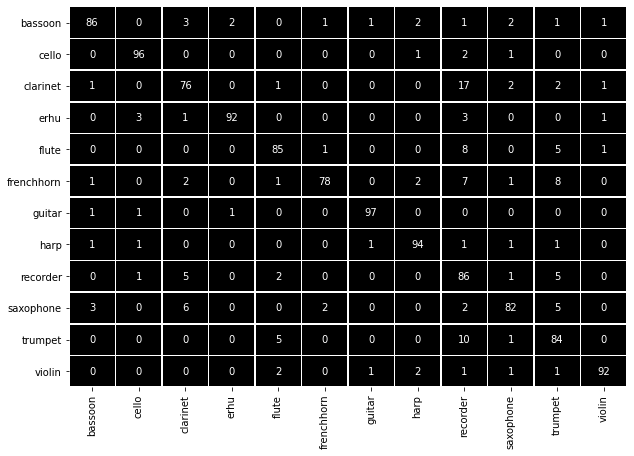

In [ ]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from IPython.display import display
class_names = list(test_baseline.class_indices)
df_cm = pd.DataFrame(conf_matrix, index = [i for i in class_names],
                  columns = [i for i in class_names])
df_cm
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True,fmt='g',cbar=False,
                cmap=ListedColormap(['black']),
                linewidths=0.5)
display(df_cm)

Here we present some photos with their alphapose which were misclassified.

[8, 18, 25, 30, 32, 48, 62, 63, 66, 92, 93, 94, 98, 99, 142, 143, 155, 173, 206, 208, 210, 213, 217, 218, 224, 226, 227, 229, 236, 237, 247, 254, 256, 259, 266, 269, 271, 273, 282, 286, 288, 295, 333, 338, 346, 360, 368, 369, 372, 373, 404, 406, 408, 418, 419, 423, 436, 438, 452, 453, 454, 458, 465, 483, 485, 502, 504, 505, 506, 507, 512, 517, 521, 522, 539, 546, 556, 557, 559, 566, 568, 569, 578, 591, 592, 593, 599, 601, 654, 664, 707, 730, 745, 789, 795, 799, 820, 821, 824, 849, 855, 857, 859, 866, 873, 874, 884, 885, 889, 897, 900, 914, 921, 928, 940, 945, 946, 955, 958, 970, 971, 972, 973, 975, 976, 981, 992, 998, 1000, 1010, 1011, 1029, 1039, 1049, 1058, 1061, 1066, 1068, 1072, 1074, 1076, 1083, 1087, 1092, 1105, 1124, 1151, 1156, 1168, 1171, 1185, 1191]


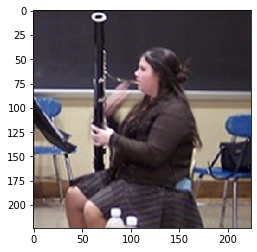

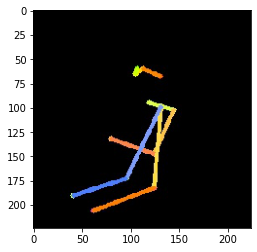

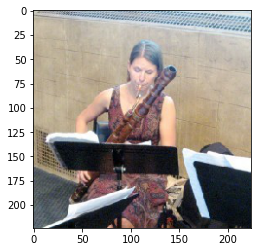

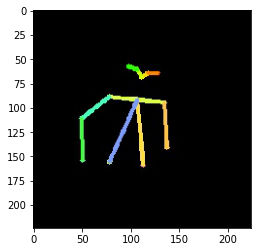

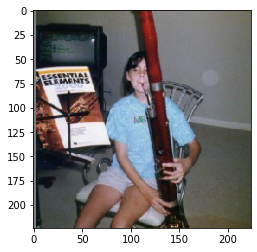

...

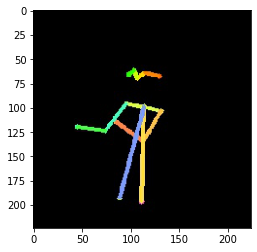

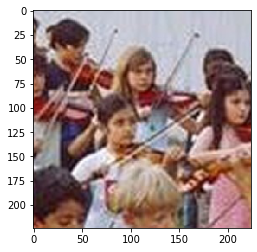

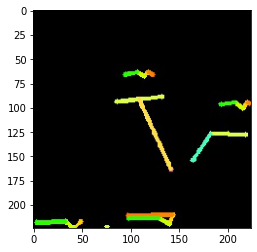

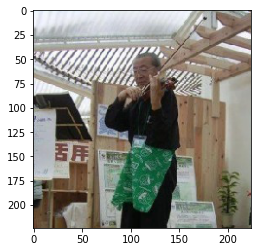

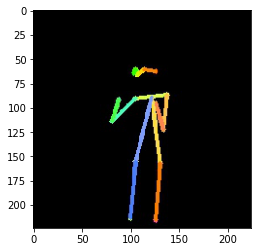

In [ ]:
#clarient class 3 has a lot of mistakes, print images


predicted_test = np.argmax(final_model.predict([features_baseline_test,features_pose_test]), axis=1)
ground_truth = np.argmax(test_labels_baseline,axis=1)
compared = predicted_test == ground_truth
j = 0
k=0
false_predictions = []
good_predictions = []
for i in compared:
  if(i==False):
    false_predictions.append(j)
  else:
    good_predictions.append(k)
  j=j+1
  k=k+1
print(false_predictions)
for i,j in zip(false_predictions,false_predictions):
  plt.imshow(test_features_baseline[i]/255.)
  plt.show()
  plt.imshow(test_features_alphapose[j]/255.)
  plt.show()
#plt.imshow(test_features_baseline[206]/255.)
#plt.show()
#plt.imshow(test_features_alphapose[230]/255.)

In [ ]:
for i,j in zip(good_predictions,good_predictions[-30:-1]):
  plt.imshow(test_features_baseline[i]/255.)
  plt.show()
  plt.imshow(test_features_alphapose[j]/255.)
  plt.show()


McNemar's statistical test

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import fisher_exact
from statsmodels.stats.contingency_tables import mcnemar
y_predict = np.argmax(final_model.predict([features_baseline_test,features_pose_test]), axis=1)
baseline_labels= np.argmax(baseline_model.predict(test_features_baseline),axis=1)
final_model_labels = y_predict
gated_model_true_false= baseline_labels==np.argmax(test_labels_baseline,axis=1)   #==final_model_labels
np.where(final_model=='red ', 'red', final_model)
np.where(final_model=='green ', 'green', final_model) 
other_model_true_false=(np.argmax(test_labels_baseline,axis=1)==final_model_labels)# baseline labels same with final mode labels
print(gated_model_true_false)
print(other_model_true_false)
#print(other_model_true_false)
#print(gated_model_true_false)
#gated_model=np.load("output_GMU_secondtobest.npy",allow_pickle=True)[:,1]
tab = pd.crosstab(gated_model_true_false, other_model_true_false)
print(tab)
result = mcnemar(tab, exact=True)
level_of_significance = 0.05
# summarize the findingprint("mcnemar p_value=", result.pvalue, "statistic", result.statistic)
# interpret the p-value
if result.pvalue > level_of_significance:
        print('Classifiers have the same error rate')
else:
        print('Classifiers have different performance')

  
        




[ True False False ...  True  True  True]
[ True  True  True ...  True  True  True]
col_0  False  True 
row_0              
False    105     75
True      47    973
Classifiers have different performance


In [ ]:
print("End of project")